In [1]:
import os, glob

In [2]:
import pandas as pd
import geopandas as gpd

In [3]:
import rioxarray as rioxr
from rasterio.enums import Resampling

In [4]:
import dask

In [5]:
from pyce import mnt, shape, sheds

# 1. Lidar HD

In [6]:
home_dir = "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/"

In [7]:
dwnld_dir = os.path.join(home_dir, "dem/dwnld_tiles/")

In [8]:
run_extensions = "202603"

## 1.1 Identify lidar HD tiles

In [71]:
gdf_bv = gpd.read_file(os.path.join(home_dir, "bv/bv_convexHull.shp"))

In [72]:
gdf_lidar = gpd.read_file(os.path.join(home_dir, "../grid_lidar_hd/TA_diff_pkk_lidarhd_classe.shp"))

In [73]:
gdf_lakes_lidar = mnt.identify_lidarhd_tiles(df=gdf_bv, 
                                             gdf_lidar=gdf_lidar,
                                             buffer=0, 
                                             plot=True)                                       

In [74]:
len(set(gdf_lakes_lidar["nom_pkk"]))

104

## 1.2 Save list of files

In [75]:
gdf_to_save = gdf_lakes_lidar.drop(columns=["geometry"])
gdf_to_save["dir_tile_dwnld"] = dwnld_dir
gdf_to_save["tile_name"] = gdf_to_save["nom_pkk"].apply(lambda x: mnt._get_lidar_basename(x))
gdf_to_save = gdf_to_save[["lake_name", "tile_name", "dir_tile_dwnld", "url_telech"]]

In [76]:
gdf_to_save.to_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}.csv"), index=False)

## 1.3 Download lidarHD tiles

In [22]:
mnt.download_lidarhd_tiles(gdf_lakes_lidar,
                           dwnld_dir=dwnld_dir, 
                           force=False,
                           num_workers=6,
                           compute=True)

Number of tiles to download: 16
Download will start ...
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0956_6422_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0958_6424_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0958_6421_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0956_6421_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0956_6424_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v1/AUTH_63234f509d6048bca3c9fd7928720ca1/ppk-lidar/QN/LHD_FXX_0959_6424_PTS_O_LAMB93_IGN69.copc.laz
Download done: https://storage.sbg.cloud.ovh.net/v

## 1.4 Process lidar data

### 1.4.1. Special lakes

Some lakes are overlapping over multiple corners of lidar HD tiles. 

Lidar data being disturbed on water surface, one needs to merge such tiles to allow triangulation to work by merging such tiles two by two.

One need to change the associated names in the dataframe file list to process afterwards (see $1.4.3 processing)

* NOT NEEDED for the extra lakes (pontet, lauzon, lauvitel, benit, pourssolet) - but can be for others
* HERE we simply used direct MNT from IGN for Lauvitel - see below


#### Lauvitel

* Here, raw Point Clouds Data are of bad quality when processing them locally. 
* NaN are still present at some corners of the tiles, creating steps and holes at the edges of the tiles, hard to correct afterwards. 
* After some failure tests, I decided to use directly the processed MNT from IGN (not accessible at the time I developped this code) that are of much better quality. 
* This option would now be the one to prefer
* However the resolution is 50cm, leading to very large data file for big water shed such as Lauvitel. A upscaling is thus needed before deriving the sheds

The downloading is made manually frmo this webpage (25.02.2026): https://cartes.gouv.fr/telechargement/IGNF_MNT-LIDAR-HD

Replace tiles name

In [40]:
gdf_lidar = pd.read_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}.csv")).sort_values(by="tile_name")

In [41]:
lau_mnt_tiles = glob.glob("/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/*MNT*.tif")
lau_mnt_tiles.sort()

In [42]:
tiles_mnt = [os.path.basename(t).split(".")[0] for t in lau_mnt_tiles]
tiles_mnt = [t for t in tiles_mnt if any(gdf_lidar["tile_name"].isin([t.replace("MNT_O_0M50", "PTS_O")]))] # Keep only the list obtained from the convexHull
tiles_pts = [os.path.basename(t).replace("MNT_O_0M50", "PTS_O").split(".")[0] for t in lau_mnt_tiles] # Tiles id from section 1.1

In [43]:
gdf_lidar.loc[gdf_lidar["tile_name"].isin(tiles_pts),"tile_name"] = tiles_mnt

In [47]:
gdf_lidar.loc[gdf_lidar["tile_name"].isin(tiles_mnt),"tile_name"] = [t.replace("MNT_O_0M50", "MNT_O_2M00") for t in tiles_mnt]

### 1.4.2 Save MNT tiles

In [48]:
gdf_lidar.to_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}_merged.csv"), index=False)

### 1.4.3 Upsclae MNT IGN

I choose 2m for Lauvitel since there were some bugs @1m that I couldn't solve

In [15]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}_merged.csv"))

In [44]:
df_lakes = df_lakes.loc[df_lakes.lake_name == "lauvitel"]

In [45]:
df_lakes = df_lakes.assign(dir_tile_process = os.path.join(home_dir, "dem/process_tiles/"))

In [46]:
for ti in range(df_lakes.count().values[0]):
    
    tile_mnt = os.path.join(df_lakes.iloc[ti]["dir_tile_process"], df_lakes.iloc[ti]["tile_name"]+".tif")
    print(tile_mnt)
    
    mnt_ign = rioxr.open_rasterio(tile_mnt)
    mnt_ign_1m = mnt_ign.rio.reproject(mnt_ign.rio.crs, 
                                       shape=(int(mnt_ign.rio.height* 1/4.), # 0.5 cm to 2m = divied by 4
                                              int(mnt_ign.rio.width * 1/4.)), # This function could be inserted into pyce.raster #TODO
                                       resampling=Resampling.bilinear)

    mnt_ign_1m.rio.to_raster(tile_mnt.replace("MNT_O_0M50", "MNT_O_2M00"))

/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6431_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6432_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6433_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6434_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6435_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6436_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0938_6437_MNT_O_0M50_LAMB93_IGN69.tif
/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/process_tiles/LHD_FXX_0939_6

### 1.4.4 Processing (triangulation)

In [15]:
gdf_lidar = pd.read_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}_merged.csv"))

In [49]:
gdf_lidar = gdf_lidar.loc[~gdf_lidar.lake_name.isin(["pourssolet", "benit", "lauvitel"])] # Remove already done AND lauvitel as I download ot directly the MNT from IGN

In [50]:
process_dir = os.path.join(home_dir, "dem/process_tiles/")
resolution = 1

Check how many tiles left to process

In [51]:
lidar_files_tif = [os.path.join(process_dir, tile_name)+".tif" for tile_name in gdf_lidar["tile_name"]]

In [52]:
count=0
for file in lidar_files_tif:
    if not os.path.exists(file): 
        count+=1
print(f"Number of tiles to process: {count}")

Number of tiles to process: 0


Processing

In [23]:
lidar_files = [os.path.join(tile_dir, tile_name)+".copc.laz" for tile_dir, tile_name in zip(gdf_lidar["dir_tile_dwnld"], gdf_lidar["tile_name"])]

In [24]:
lidar_files

['/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0943_6434_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0942_6434_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0943_6433_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0941_6434_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0939_6435_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0941_6435_6436_6435_6436_6435_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0939_6434_PTS_O_LAMB93_IGN69.copc.laz',
 '/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_la

In [25]:
# For Lauvitel only
lidar_files = ['/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/dem/dwnld_tiles/LHD_FXX_0941_6435_6436_6435_6436_6435_PTS_O_LAMB93_IGN69.laz']

In [26]:
%%time
mnt.process_lidarhd_tiles(lidar_files, 
                          save_dir=process_dir, 
                          resolution=resolution, 
                          num_workers=1, 
                          redo=False)

0....10....20....30....40....50....60....70....80....90....100 - done.
CPU times: user 207 ms, sys: 19.4 ms, total: 226 ms
Wall time: 3min 42s


## 1.5 Merge DEM tiles by lake

In [49]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"dem/lacsSentinelles_list_MNT_IGN_lidarHD_{run_extensions}_merged.csv"))

In [50]:
df_lakes = df_lakes.loc[df_lakes.lake_name == "lauvitel"]

In [51]:
df_lakes

,lake_name,tile_name,dir_tile_dwnld,url_telech
12,lauvitel,LHD_FXX_0938_6431_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
13,lauvitel,LHD_FXX_0938_6432_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
14,lauvitel,LHD_FXX_0938_6433_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
15,lauvitel,LHD_FXX_0938_6434_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
16,lauvitel,LHD_FXX_0938_6435_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
17,lauvitel,LHD_FXX_0938_6436_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
18,lauvitel,LHD_FXX_0938_6437_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
19,lauvitel,LHD_FXX_0939_6431_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
20,lauvitel,LHD_FXX_0939_6432_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...
21,lauvitel,LHD_FXX_0939_6433_MNT_O_2M00_LAMB93_IGN69,/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_l...,https://storage.sbg.cloud.ovh.net/v1/AUTH_6323...


In [52]:
df_lakes.loc[:, "dir_tile_process"] = os.path.join(home_dir, "dem/process_tiles/")

In [53]:
%%time
for lake in set(df_lakes.lake_name):
    print(lake)
    df = df_lakes.loc[df_lakes.lake_name == lake]
    dem_merged = mnt.merge_dem_tiles(dem=df, 
                                     df_metadata = dict(col_name_dir="dir_tile_process",
                                                        col_name_tile="tile_name", 
                                                        tile_extension=".tif"),
                                     epsg_mnt="epsg:2154",
                                     save_name=os.path.join(home_dir, f"dem/dem_1m/{lake.replace(' ', '_').lower()}.tif"))

lauvitel
CPU times: user 1.23 s, sys: 76.1 ms, total: 1.31 s
Wall time: 1.31 s


# 2. Get sheds

In [6]:
home_dir = "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/"

In [7]:
run_extensions = "202603"

## 2.1 Coordinates file

* Deal with coordinates files vs. centers and outlets shapefiles
* Here the coordinates (centers and outlets) are generated through QGIS & then saved as csv files
* See also section 2.4.1 to update outlet shapefile and csv file when deriving sheds

In [120]:
center_lakes = gpd.read_file(os.path.join(home_dir, f"coords/lacsSentinelles_centers_{run_extensions}.shp")).sort_values(by="lake_name").reset_index(drop=True)
outlet_lakes = gpd.read_file(os.path.join(home_dir, f"coords/lacsSentinelles_outlets_{run_extensions}.shp")).sort_values(by="lake_name").reset_index(drop=True)

In [121]:
# Check if centers/outlets have the same list and order of lakes
all(center_lakes["lake_name"] == outlet_lakes["lake_name"])

True

In [122]:
coords_lakes = pd.DataFrame()

coords_lakes["lake_name"] = outlet_lakes.lake_name

coords_lakes["proj_center"] = center_lakes.crs.to_string()
coords_lakes["x_center"] = center_lakes.geometry.x
coords_lakes["y_center"] = center_lakes.geometry.y

coords_lakes["proj_outlet"] = outlet_lakes.crs.to_string()
coords_lakes["x_outlet"] = outlet_lakes.geometry.x
coords_lakes["y_outlet"] = outlet_lakes.geometry.y

In [123]:
coords_lakes

,lake_name,proj_center,x_center,y_center,proj_outlet,x_outlet,y_outlet
0,benit,EPSG:2154,971010.723146,6.553582e+06,EPSG:2154,971141.993049,6.553620e+06
1,lauvitel,EPSG:2154,941506.755606,6.434696e+06,EPSG:2154,941899.814262,6.435143e+06
2,lauzon,EPSG:2154,958611.615446,6.421559e+06,EPSG:2154,958626.158608,6.421545e+06
3,pontet,EPSG:2154,963802.757515,6.444676e+06,EPSG:2154,963718.941028,6.444658e+06
4,pourssolet,EPSG:2154,928171.841512,6.443330e+06,EPSG:2154,928287.874657,6.443402e+06


In [124]:
coords_lakes.to_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"), index=False)

In [125]:
outlet_lakes["x_outlet"] = outlet_lakes.geometry.x
outlet_lakes["y_outlet"] = outlet_lakes.geometry.y

In [126]:
outlet_lakes

,lake_name,x_outlet,y_outlet,geometry
0,benit,971141.993049,6.553620e+06,POINT (971141.993 6553619.943)
1,lauvitel,941899.814262,6.435143e+06,POINT (941899.814 6435142.87)
2,lauzon,958626.158608,6.421545e+06,POINT (958626.159 6421545.408)
3,pontet,963718.941028,6.444658e+06,POINT (963718.941 6444658.171)
4,pourssolet,928287.874657,6.443402e+06,POINT (928287.875 6443401.68)


In [127]:
outlet_lakes.to_file(os.path.join(home_dir, f"coords/lacsSentinelles_outlets_{run_extensions}.shp"))

## 2.2 Get lake shapes

* To derive a watershed, one needs to flatten and burn flat parts of a DEM, sush as lakes
* Here we identify lakes countours (i.e., lake shapes) from the DEM ahead of the water shed estimation
* We identify such regions based on the altitude of lakes central point +/- an elevation threshold. 
* Everything within these elevations are considered as lakes, thresholds depend on the lake and are evaluated empirically
* Manual editing is however still needed on QGIS afterwards

In [8]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"))

### Specify flatenning threshold

In [9]:
df_lakes["thresh"] = 0.2 # in meters

In [10]:
df_lakes

,lake_name,proj_center,x_center,y_center,proj_outlet,x_outlet,y_outlet,thresh
0,benit,EPSG:2154,971010.723146,6.553582e+06,EPSG:2154,971141.993049,6.553620e+06,0.2
1,lauvitel,EPSG:2154,941506.755606,6.434696e+06,EPSG:2154,941972.798984,6.435230e+06,0.2
2,lauzon,EPSG:2154,958611.615446,6.421559e+06,EPSG:2154,958626.158608,6.421545e+06,0.2
3,pontet,EPSG:2154,963802.757515,6.444676e+06,EPSG:2154,963718.941028,6.444658e+06,0.2
4,pourssolet,EPSG:2154,928171.841512,6.443330e+06,EPSG:2154,928287.874657,6.443402e+06,0.2


In [11]:
#lake_sel = ["Blanc du Carro", "Lauzanier", "Pisses", "Aumar", "Bresses inferieur", "Bresses superieur"]
lake_sel_low = ["lauzon", "pontet"]
lake_sel_high = ["lauvitel"]
#lake_sel_very_high = ["Izourt"]

In [12]:
#df_lakes.loc[df_lakes.lake_name.isin(lake_sel), "thresh"] = 0.1
df_lakes.loc[df_lakes.lake_name.isin(lake_sel_low), "thresh"] = 0.1
df_lakes.loc[df_lakes.lake_name.isin(lake_sel_high), "thresh"] = 3
#df_lakes.loc[df_lakes.lake_name.isin(lake_sel_very_high), "thresh"] = 7

### Run lake shape

In [13]:
list_lakes = list(set(df_lakes["lake_name"]))

In [15]:
gdf_lake = []

for lake in list_lakes:
    dem = rioxr.open_rasterio(os.path.join(home_dir, f"dem/dem_1m/{lake.replace(' ', '_')}.tif"))
                              
    d_lake = df_lakes.loc[df_lakes.lake_name == lake]
    
    lake_shp = sheds.run_get_lake_shape(dem=dem, 
                                        xy_lake=[d_lake["x_center"].values[0], 
                                                 d_lake["y_center"].values[0]],
                                        crs_lake=d_lake["proj_center"].values[0],
                                        flattening_thresh=d_lake["thresh"].values[0],
                                        buffer_size = 2, 
                                        buffer_delta = 0, 
                                        name_lake=lake,
                                        as_gdf=True)  
    gdf_lake.append(lake_shp)

In [16]:
%%time
gdf_lake = dask.compute(gdf_lake, num_workers=4)

CPU times: user 7.23 s, sys: 879 ms, total: 8.1 s
Wall time: 4.04 s


In [17]:
gdf_lake = pd.concat([gdf_lake[0][n] for n in range(len(gdf_lake[0]))]).sort_values(by="lake_name").reset_index(drop=True)

In [18]:
gdf_lake.explore(tiles="Esri.WorldImagery")

In [20]:
gdf_lake.to_file(os.path.join(home_dir, f"bv/lacsSentinelles_lakes_auto_{run_extensions}.shp"))

## 2.3 Burn lake shapes

!!! After manual editing !!!
* Editing needed on QGIS to clean lake shapes

* IMPORTANT : 
    * One also needs to delineate manually other lakes within potential water sheds to improve results
    * I personnally added them with the following naming within the orignal shape file: 'lake_Lxx' with xx being increasing numbers   
    * Final file is:  
        * "lacsSentinelles_lakes_{run_extensions}.shp"

### Get data

In [34]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"))

In [35]:
lake_shapes = gpd.read_file(os.path.join(home_dir, f"bv/lacsSentinelles_lakes_{run_extensions}.shp"))

### On 1m data

In [37]:
list_lakes = list(set(df_lakes["lake_name"]))

In [39]:
%%time
for lake in list_lakes:
    dem = rioxr.open_rasterio(os.path.join(home_dir, f"dem/dem_1m/{lake.replace(' ', '_')}.tif"))
    lake_shp = lake_shapes.loc[lake_shapes["lake_name"] == lake]

    dem_burnt = sheds.burn_lake_to_dem(dem=dem, 
                                       lake_shp=lake_shp, 
                                       method="min",
                                       save_name=os.path.join(home_dir, f"dem/dem_1m/{lake.replace(' ', '_')}_burnt.tif"))

CPU times: user 1.03 s, sys: 1.38 s, total: 2.42 s
Wall time: 2.41 s


## 2.4 Get sheds

#### Get data + run

In [55]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"))

In [56]:
df_lakes

,lake_name,proj_center,x_center,y_center,proj_outlet,x_outlet,y_outlet
0,benit,EPSG:2154,971010.723146,6.553582e+06,EPSG:2154,971141.993049,6.553620e+06
1,lauvitel,EPSG:2154,941506.755606,6.434696e+06,EPSG:2154,941972.798984,6.435230e+06
2,lauzon,EPSG:2154,958611.615446,6.421559e+06,EPSG:2154,958626.158608,6.421545e+06
3,pontet,EPSG:2154,963802.757515,6.444676e+06,EPSG:2154,963718.941028,6.444658e+06
4,pourssolet,EPSG:2154,928171.841512,6.443330e+06,EPSG:2154,928287.874657,6.443402e+06


In [57]:
list_lakes = list(set(df_lakes["lake_name"]))
list_lakes =  ['benit', 'pourssolet']

In [58]:
gdf_shed = []

for lake in list_lakes:
    
    dem = rioxr.open_rasterio(os.path.join(home_dir, f"dem/dem_1m/{lake.replace(' ', '_')}_burnt.tif"))
    
    d_lake = df_lakes.loc[df_lakes["lake_name"] == lake]
                              
    shed = sheds.run_get_shed(dem=dem,
                              xy_outlet=[d_lake["x_outlet"].values[0],
                                         d_lake["y_outlet"].values[0]],
                              crs_outlet=d_lake["proj_outlet"].values[0],
                              name_shed=lake,
                              buffer_size=5, #in unit of crs / to clean resulting shed shape (merging multipolygons)
                              buffer_delta=0, #in unit of crs / to clean resulting shed shape (merging multipolygons)
                              save_acc=os.path.join(home_dir, f"bv/acc_1m/{lake.replace(' ', '_')}_acc.tif"))
    gdf_shed.append(shed)

In [59]:
%%time
# Can take about 2-3 mins per lake
gdf_shed = dask.compute(gdf_shed, num_workers=4)

CPU times: user 1min 27s, sys: 5.64 s, total: 1min 32s
Wall time: 1min 22s


#### Save sheds

In [60]:
gdf_shed = pd.concat([gdf_shed[0][n] for n in range(len(gdf_shed[0]))]).sort_values(by="lake_name").reset_index(drop=True)

In [72]:
gdf_to_save = gdf_shed[["lake_name","geometry"]]

In [74]:
# To run if the shed file already exists AND want to replace only some lakes
gdf_shed_all = gpd.read_file(os.path.join(home_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

# Replace existing lake
gdf_shed_all.loc[gdf_shed_all.lake_name.isin(gdf_to_save.lake_name), gdf_shed_all.columns] = gdf_to_save[gdf_shed_all.columns] 

# Add lake not yet saved if existing
not_saved_yet = gdf_to_save.loc[~gdf_to_save.lake_name.isin(gdf_shed_all.lake_name)] 
if not_saved_yet.shape[0]!=0:
        gdf_shed_all = pd.concat([gdf_shed_all, not_saved_yet])

In [75]:
# To avoid erasing the first file in case
gdf_to_save = gdf_shed_all 

In [78]:
gdf_to_save.to_file(os.path.join(home_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

#### Save snap

In [79]:
gdf_snap = shape.df_to_gdf(gdf_shed[["lake_name","x_snap","y_snap"]],
                            x_col="x_snap",
                            y_col="y_snap",
                            crs=d_lake["proj_outlet"].values[0]
                           )

In [80]:
# To run if the shed file already exists AND want to replace only some lakes
gdf_snap_all = gpd.read_file(os.path.join(home_dir, f"bv/lacsSentinelles_snap_{run_extensions}.shp"))

# Replace existing lake
gdf_snap_all.loc[gdf_snap_all.lake_name.isin(gdf_snap.lake_name), gdf_snap_all.columns] = gdf_snap[gdf_snap_all.columns]

# Add lake not yet saved if existing
not_saved_yet = gdf_snap.loc[~gdf_snap.lake_name.isin(gdf_snap_all.lake_name)] 
if not_saved_yet.shape[0]!=0:
        gdf_snap_all = pd.concat([gdf_snap_all, not_saved_yet])

# To avoid erasing the first file in case
gdf_snap = gdf_snap_all 

In [82]:
gdf_snap.to_file(os.path.join(home_dir, f"bv/lacsSentinelles_snap_{run_extensions}.shp"))

#### Update outlets from shape to file
!Only if modified in QGIS!
* This is needed to ensure correct estimation of the water shed
* Move the outlet position so the shed and the snap point correspond well to the true outlet of the lake
* To be checked on QGIS, and modified if necessary 
* Then re-run the water shed estimation AFTER having modified the coords file here below

In [41]:
gdf_outlet = gpd.read_file(os.path.join(home_dir, f"coords/lacsSentinelles_outlets_{run_extensions}.shp"))

In [42]:
gdf_outlet

,lake_name,x_outlet,y_outlet,geometry
0,benit,971141.993049,6.553620e+06,POINT (971141.993 6553619.943)
1,lauvitel,941899.814262,6.435143e+06,POINT (941972.799 6435230.393)
2,lauzon,958626.158608,6.421545e+06,POINT (958626.159 6421545.408)
3,pontet,963718.941028,6.444658e+06,POINT (963718.941 6444658.171)
4,pourssolet,928287.874657,6.443402e+06,POINT (928287.875 6443401.68)


In [43]:
df_lakes = pd.read_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"))

In [44]:
df_lakes

,lake_name,proj_center,x_center,y_center,proj_outlet,x_outlet,y_outlet
0,benit,EPSG:2154,971010.723146,6.553582e+06,EPSG:2154,971141.993049,6.553620e+06
1,lauvitel,EPSG:2154,941506.755606,6.434696e+06,EPSG:2154,941899.814262,6.435143e+06
2,lauzon,EPSG:2154,958611.615446,6.421559e+06,EPSG:2154,958626.158608,6.421545e+06
3,pontet,EPSG:2154,963802.757515,6.444676e+06,EPSG:2154,963718.941028,6.444658e+06
4,pourssolet,EPSG:2154,928171.841512,6.443330e+06,EPSG:2154,928287.874657,6.443402e+06


In [45]:
df_lakes["x_outlet"] = gdf_outlet["geometry"].x
df_lakes["y_outlet"] = gdf_outlet["geometry"].y

In [46]:
df_lakes.to_csv(os.path.join(home_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"), index=False)

## 2.5 Remove lake from sheds

### Data

In [18]:
gdf_sheds = gpd.read_file(os.path.join(home_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

In [19]:
lake_shapes = gpd.read_file(os.path.join(home_dir, f"bv/lacsSentinelles_lakes_{run_extensions}.shp"))

In [40]:
# Add Plan Vianney to sub Lake of Lauvitel
lake_plan = gpd.read_file(f"/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/main_lakes/bv/lacsSentinelles_lakes_202409.shp")
lake_shapes = pd.concat([lake_shapes, 
                         lake_plan.loc[lake_plan.lake_name=="Plan Vianney"]]
                       ).replace({"Plan Vianney": "lauvitel_L1"}
                    ).reset_index(drop=True)
lake_shapes.to_file(os.path.join(home_dir, f"bv/lacsSentinelles_lakes_{run_extensions}.shp"))

In [20]:
def get_sub_lakes(lake_name):
    sub_L = len(lake_name.split("_L"))
    sub_B = len(lake_name.split("_B"))
    return (sub_L > 1) or (sub_B >1)

In [21]:
# Remove sub lakes to still account for them in the wahter shed
lake_shapes_no_sub = lake_shapes[~lake_shapes.apply(lambda row: get_sub_lakes(row["lake_name"]), axis=1)]

### Process

In [33]:
# Make sure to align the frames
gdf_sheds = gdf_sheds.sort_values("lake_name").reset_index(drop=True)
lake_shapes_no_sub = lake_shapes_no_sub.sort_values("lake_name").reset_index(drop=True)

In [34]:
# Make the difference with lake shapes -> return GeoSeries
sheds_no_lakes = gdf_sheds.difference(lake_shapes_no_sub, align=True) # symmetric diff might be usefull to remove lake border in some cases

In [35]:
gdf_sheds = gpd.GeoDataFrame({"lake_name":gdf_sheds.lake_name}, 
                             geometry=sheds_no_lakes, 
                             crs=gdf_sheds.crs)

### Save

In [36]:
gdf_sheds.to_file(os.path.join(home_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

# 3. Products

Create delivery products for each lake
* Coordinates (csv)
* Lakes (shp)
* Wateshed (shp)
* Landcover (shp)

For regional products, one needs beforehand to select the given lakes from the original shapefile (see section 3.5)

In [1]:
data_dir = "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes"

In [2]:
save_dir = "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/"

In [3]:
run_extensions = "202603"

## 3.1 Coordinates

In [10]:
coords = pd.read_csv(os.path.join(data_dir, f"coords/lacsSentinelles_coords_{run_extensions}.csv"))

In [11]:
coords.to_csv(os.path.join(save_dir, f"ancillary/lacsSentinelles_coords_{run_extensions}.csv"), index=False)

## 3.2 Lakes

In [12]:
lakes_shp = gpd.read_file(os.path.join(data_dir, f"bv/lacsSentinelles_lakes_{run_extensions}.shp"))

In [13]:
lakes_shp = lakes_shp.sort_values(by="lake_name").reset_index(drop=True)

In [14]:
lakes_shp

,lake_name,geometry
0,benit,"POLYGON ((971144.74 6553631.22, 971152.793 655..."
1,lauvitel,"POLYGON ((941213.002 6434630.001, 941213 64346..."
2,lauvitel_L1,"POLYGON ((939794.758 6433329.645, 939794.758 6..."
3,lauzon,"POLYGON ((958591.192 6421566.855, 958588.607 6..."
4,pontet,"POLYGON ((963821.951 6444590, 963816.622 64446..."
5,pourssolet,"POLYGON ((928302.114 6443403.606, 928304.173 6..."


#### Lake by lake

In [15]:
lake_list = list(set(coords.lake_name)) #Not to get lakes with "_Lxx"

In [16]:
for lake in lake_list:
    
    # Create folder if not existing
    if not os.path.exists(os.path.join(save_dir, f"lake_by_lake/{lake.lower()}")):
        os.mkdir(os.path.join(save_dir, f"lake_by_lake/{lake.lower()}"))
        
    my_lake = lakes_shp.loc[lakes_shp["lake_name"].str.startswith(lake)]
    my_lake.to_file(os.path.join(save_dir, f"lake_by_lake/{lake}/lacsSentinelles_lakes_{run_extensions}_{lake}.shp"))

## 3.3 Sheds

In [17]:
sheds = gpd.read_file(os.path.join(data_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

#### Lake by lake

In [19]:
lake_list = list(set(sheds.lake_name))

In [20]:
for lake in lake_list:
    
    # Create folder if not existing
    if not os.path.exists(os.path.join(save_dir, f"lake_by_lake/{lake.lower()}")):
        os.mkdir(os.path.join(save_dir, f"lake_by_lake/{lake.lower()}"))
        
    my_shed = sheds.loc[sheds["lake_name"].str.startswith(lake)]
    my_shed.to_file(os.path.join(save_dir, f"lake_by_lake/{lake}/lacsSentinelles_sheds_{run_extensions}_{lake}.shp"))

## 3.4 Landcover

In [21]:
lc_s2_alps = rioxr.open_rasterio(os.path.join(data_dir, "../landcover/carto_landcover_s2_alps_fr.tif"), mask_and_scale=True)
lc_s2_corse = rioxr.open_rasterio(os.path.join(data_dir, "../landcover/carto_landcover_s2_corse.tif"), mask_and_scale=True)
lc_s2_pyr = rioxr.open_rasterio(os.path.join(data_dir, "../landcover/carto_landcover_s2_pyr.tif"), mask_and_scale=True)

In [22]:
gdf_bv = gpd.read_file(os.path.join(data_dir, f"bv/bv_convexHull.shp"))
gdf_bv = gdf_bv.sort_values(by="lake_name").reset_index(drop=True)

### 3.4.1 Clip + reprojection 

In [23]:
lc_s2_alps = lc_s2_alps.rio.reproject(gdf_bv.crs).rio.clip(gdf_bv.geometry)
#lc_s2_corse = lc_s2_corse.rio.reproject(gdf_bv.crs).rio.clip(gdf_bv.geometry)
#lc_s2_pyr = lc_s2_pyr.rio.reproject(gdf_bv.crs).rio.clip(gdf_bv.geometry)

### 3.4.2 Compute & save TMP

#### Rasters

In [24]:
from rioxarray.exceptions import NoDataInBounds

In [25]:
def compute_lc_rst(lc_alps, lc_corse, lc_pyr, sheds_shp):
    
    for index, row in sheds_shp.iterrows(): 

        # Create folder if not existing
        if not os.path.exists(os.path.join(save_dir, f"lake_by_lake/tmp")):
            os.mkdir(os.path.join(save_dir, f"lake_by_lake/tmp"))

        if not os.path.exists(os.path.join(save_dir, f"lake_by_lake/tmp/{row.lake_name}")):
            os.mkdir(os.path.join(save_dir, f"lake_by_lake/tmp/{row.lake_name}"))
            
        print(row.lake_name)
            
        # Try to clip from one regional raster 
        try: 
            lake_raster = lc_alps.rio.clip([row.geometry], crs=sheds_shp.crs)
        except NoDataInBounds:
            try:
                lake_raster = lc_corse.rio.clip([row.geometry], crs=sheds_shp.crs)
            except NoDataInBounds:
                lake_raster = lc_pyr.rio.clip([row.geometry], crs=sheds_shp.crs)

        # Save raster       
        lake_raster.rio.to_raster(os.path.join(save_dir, f"lake_by_lake/tmp/{row.lake_name}/lacsSentinelles_landcoverS2_2017_2023_{row.lake_name}.tif"))

In [26]:
compute_lc_rst(lc_s2_alps, lc_s2_pyr, lc_s2_corse, gdf_bv)

benit
lauvitel
lauzon
pontet
pourssolet


#### Vectors

In [27]:
def gdal_vectorizing(file, lake_by_region=False):

    qgis_dir = "/home/aguerou/miniconda3/envs/py311/bin"
    
    if lake_by_region:
        shp_file = (f"{file.split('.')[0]}.shp").replace("raster", "vector")
    else:
        shp_file = f"{file.split('.')[0]}.shp"
    
    if os.path.exists(shp_file):
        os.remove(shp_file)
        
    gdal_cmd = f"{qgis_dir}/gdal_polygonize.py\
        {file}\
        -b 1\
        -f 'ESRI Shapefile' {shp_file}\
        {os.path.basename(file.split('.')[0])} LC"
        
    os.system(gdal_cmd)

In [28]:
raster_list = glob.glob(os.path.join(save_dir, "lake_by_lake/tmp/*/*.tif"))
for raster in raster_list:
    gdal_vectorizing(raster)

0...10...20...30...40...50...60...70...80...90...Creating output /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/tmp/lauzon/lacsSentinelles_landcoverS2_2017_2023_lauzon.shp of format ESRI Shapefile.
100 - done.
0...10...20...30...40...50...60...70...80...90...Creating output /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/tmp/lauvitel/lacsSentinelles_landcoverS2_2017_2023_lauvitel.shp of format ESRI Shapefile.
100 - done.
0...10...20...30...40...50...60...70...80...90...Creating output /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/tmp/pontet/lacsSentinelles_landcoverS2_2017_2023_pontet.shp of format ESRI Shapefile.
100 - done.
0...10...20...30...40...50...60...70...80...90...Creating output /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/tmp/benit/lacsSentinelles_landcoverS2_2017_2023_benit.shp of format ESRI Shapefile.
100 - done.
0...10...20...30...40...50...60...70...80...90...Creating output /

### 3.4.3 Clip to sheds + add lakes to shp + final save

In [31]:
sheds_shp = gpd.read_file(os.path.join(data_dir, f"bv/lacsSentinelles_sheds_{run_extensions}.shp"))

In [32]:
lakes_shp = gpd.read_file(os.path.join(data_dir, f"bv/lacsSentinelles_lakes_{run_extensions}.shp"))

In [33]:
from pyce import shape

In [35]:
for lake_name in sheds_shp["lake_name"]:

    print(lake_name)
    
    # Select data for given lake
    shed_lake = sheds_shp.loc[sheds_shp.lake_name==lake_name]
    water_lake = lakes_shp.loc[lakes_shp.lake_name.str.startswith(lake_name)]
    water_lake = water_lake.assign(LC=5)
    lc_lake = gpd.read_file(os.path.join(save_dir, f'lake_by_lake/tmp/{lake_name}/lacsSentinelles_landcoverS2_2017_2023_{lake_name}.shp'))
    
    # Remove lake region
    lc_lake_shp_nolake = lc_lake.overlay(water_lake, how="difference")

    # Replace by lake value (LC=5) 
    lc_shed = pd.concat([lc_lake_shp_nolake, water_lake]).reset_index(drop=True).drop(columns=["lake_name"])
    
    # Clip to sheds / at the end so the main lake is removed from the landcover
    lc_shed = lc_shed.clip(shed_lake)
    lc_shed = shape.remove_linestring(lc_shed)
    
    # Save
    lc_shed.to_file(os.path.join(save_dir, f'lake_by_lake/{lake_name}/lacsSentinelles_landcoverS2_2017_2023_{lake_name}.shp'))

benit
lauvitel
lauzon
pontet
pourssolet


### 3.4.5 Remove tmp folder

In [36]:
os.system(f"rm -r {os.path.join(save_dir, f'lake_by_lake/tmp/')}")

0

## 3.5 Regional products

In [43]:
regions = ["alps", "corse", "pyr"]
products = ["sheds", "lakes", "landcover"]

In [44]:
lake_alps = [os.path.basename(lk_path) for lk_path in glob.glob(os.path.join(save_dir, "lake_by_lake/*"))]
lake_alps.sort()
lake_pyr = ["aumar", "izourt"]
lake_corse = ["capitello", "melo", "nino"]

In [50]:
for prod in products: 
    
    for reg, lake_list in zip(regions, [lake_alps, lake_corse, lake_pyr]):
        shp_prod_reg = pd.DataFrame()
        
        for lake in lake_list:
            shp_lake = gpd.read_file(glob.glob(os.path.join(save_dir, f"lake_by_lake/{lake}/lacsSentinelles_{prod}*_{lake}.shp"))[0])
            shp_prod_reg = pd.concat([shp_prod_reg, shp_lake])

        shp_prod_reg.to_file(os.path.join(save_dir, f"lakes_by_region/{prod}/lacsSentinelles_{prod}_{reg}.shp"))

/home/aguerou/miniconda3/envs/py311/lib/python3.11/site-packages/pyogrio/raw.py:194: RuntimeWarning: /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/noir_du_carro/lacsSentinelles_sheds_202409_noir_du_carro.shp contains polygon(s) with rings with invalid winding order. Autocorrecting them, but that shapefile should be corrected using ogr2ogr for example.
  result = ogr_read(


# 4. Landcover statistics + plots

In [11]:
from pyce.tools.lc_mapping import LandCoverMap
from pyce_scripts import lacs_sentinelles_plots_stats

In [33]:
from importlib import reload
reload(lacs_sentinelles_plots_stats)

<module 'pyce_scripts.lacs_sentinelles_plots_stats' from '/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py'>

## 4.1 parameters

In [40]:
data_dir = ["/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/main_lakes/",
            "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/data/extra_lakes/",]

In [27]:
save_dir = "/home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/"

LC map

In [28]:
mapping_file = os.path.join("/home/aguerou/data/land_cover/item/carto_h1b/nomenclature_h1b.txt")
mapping_name = "h1b_paper"

In [29]:
lcmap = LandCoverMap(mapping_file, name=mapping_name)
lcmap = lcmap.remove_item(col_name="Code", col_val=[8, 9])
lcmap.reindex_from_col_val(col_name="Code", values=[0, 1, 6, 2, 3, 4, 5], in_place=True)

List lakes

In [30]:
list_lakes = [os.path.basename(lk_path) for lk_path in glob.glob(os.path.join(save_dir, "lake_by_lake/*"))]

## 4.2 Create CSV table

### Surface

In [47]:
reload(lacs_sentinelles_plots_stats)

<module 'pyce_scripts.lacs_sentinelles_plots_stats' from '/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py'>

In [44]:
stats_surf = lacs_sentinelles_plots_stats.get_stats_surface(lakes_list=list_lakes,
                                                            data_dir=data_dir,
                                                            save_dir=save_dir,
                                                            lcmap=lcmap,
                                                            save=True)

plan_vianney
muzelle
pormenaz
melo
bramant
lauzon
aumar
bresses_inferieur
rabuons
brevent
lauzanier
petarel
cornu
pave
sarenne
anterne
mont_coua
noir_du_carro


/home/aguerou/miniconda3/envs/py311/lib/python3.11/site-packages/pyogrio/raw.py:194: RuntimeWarning: /home/aguerou/CARRTEL/lacs_sentinelles/ls_bv_lc/delivery/lake_by_lake/noir_du_carro/lacsSentinelles_sheds_202409_noir_du_carro.shp contains polygon(s) with rings with invalid winding order. Autocorrecting them, but that shapefile should be corrected using ogr2ogr for example.
  result = ogr_read(


blanc_du_carro
arpont
capitello
lauvitel
pisses
blanc_du_bramant
jovet
corne
bionnassay
izourt
pontet
nino
merlet_superieur
benit
pourssolet
bresses_superieur
cos


### Percent

In [48]:
stats_perc = lacs_sentinelles_plots_stats.get_stats_percent(stat_shp=stats_surf,
                                                            lcmap=lcmap,
                                                            save_dir=save_dir)

## 4.3 Plots

In [49]:
lcmap_map = lcmap.reindex_from_list(range(len(lcmap.df.index)))
lcmap_map.df = lcmap_map.df.sort_values("Code")

In [50]:
lcmap.df.loc[5,"Type"] = "glacier"
lcmap.df.loc[6,"Type"] = "lakes"

In [51]:
lcmap_map = lcmap.reindex_from_list(range(len(lcmap.df.index)))
lcmap_map.df = lcmap_map.df.sort_values("Code")

In [54]:
reload(lacs_sentinelles_plots_stats)

<module 'pyce_scripts.lacs_sentinelles_plots_stats' from '/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py'>

/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py:298: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  # Histograms
/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py:312: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  # Settings
/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py:412: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  # Girds and labels
/home/aguerou/dev/pyce/src/pyce_scripts/lacs_sentinelles_plots_stats.py:298: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  # Histogr

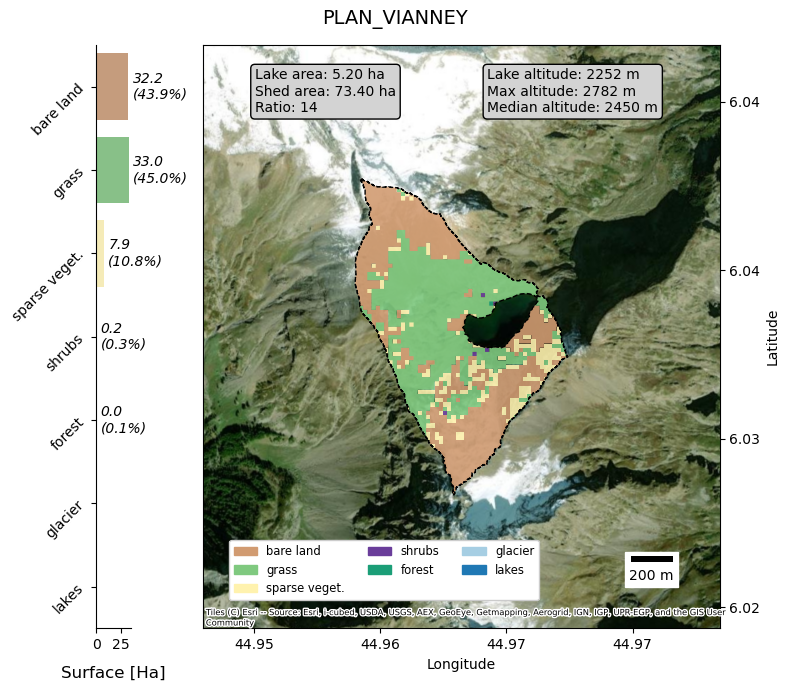

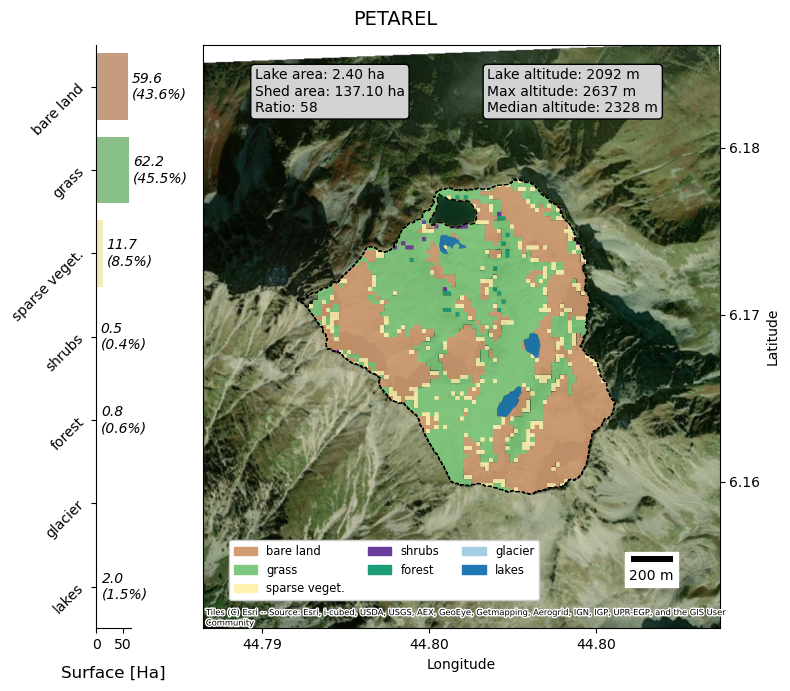

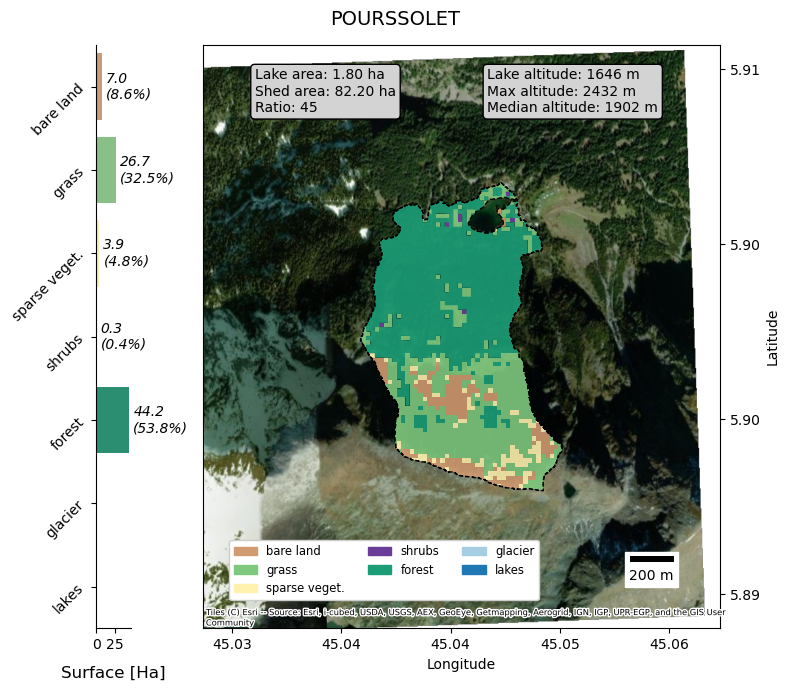

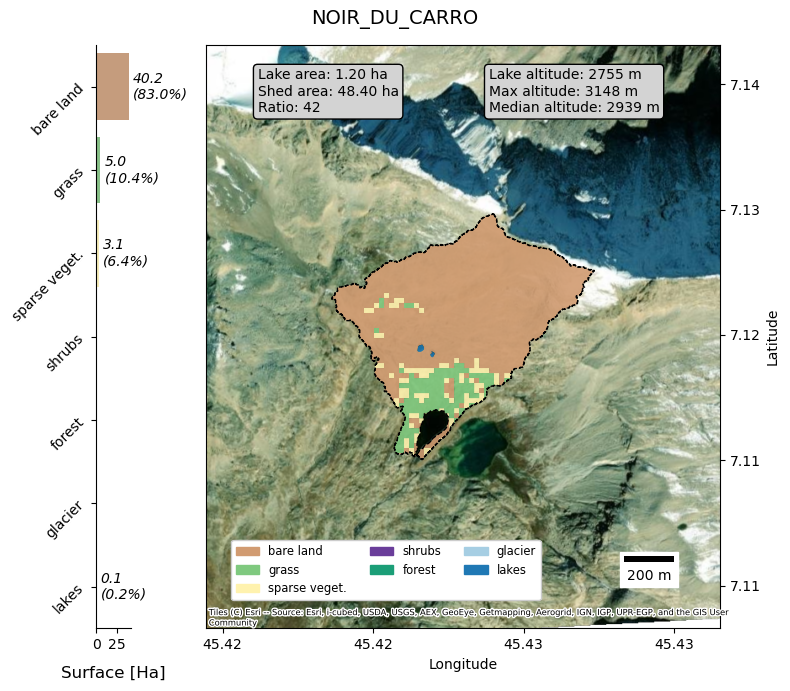

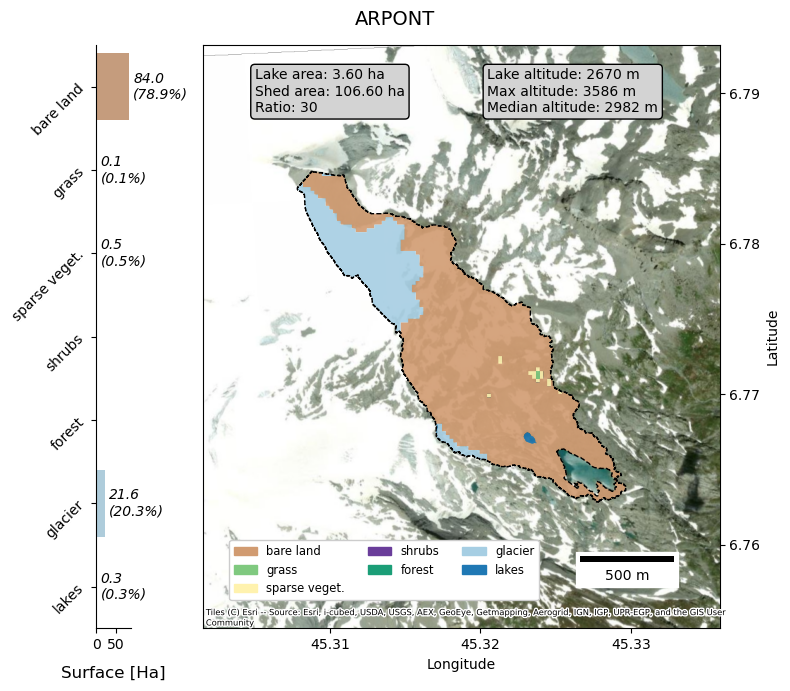

...

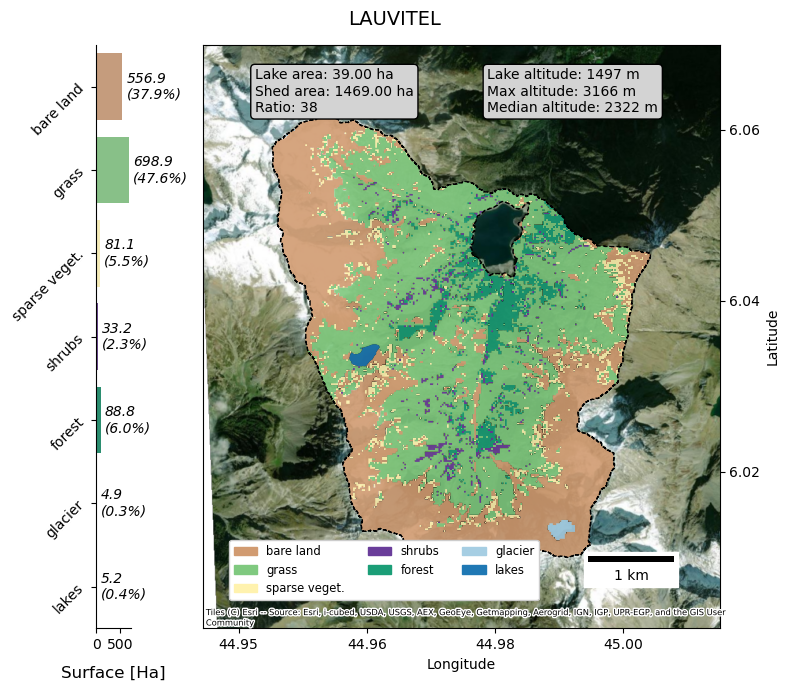

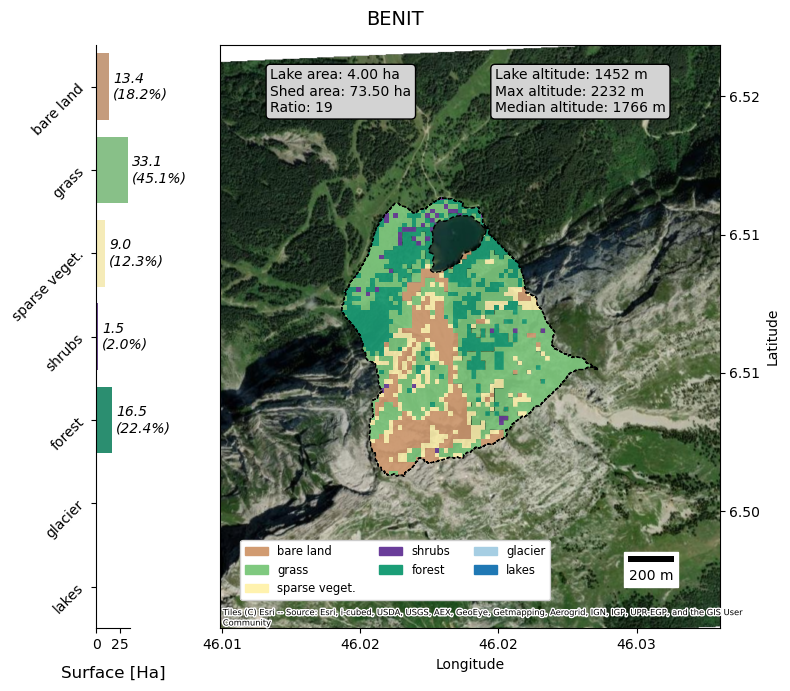

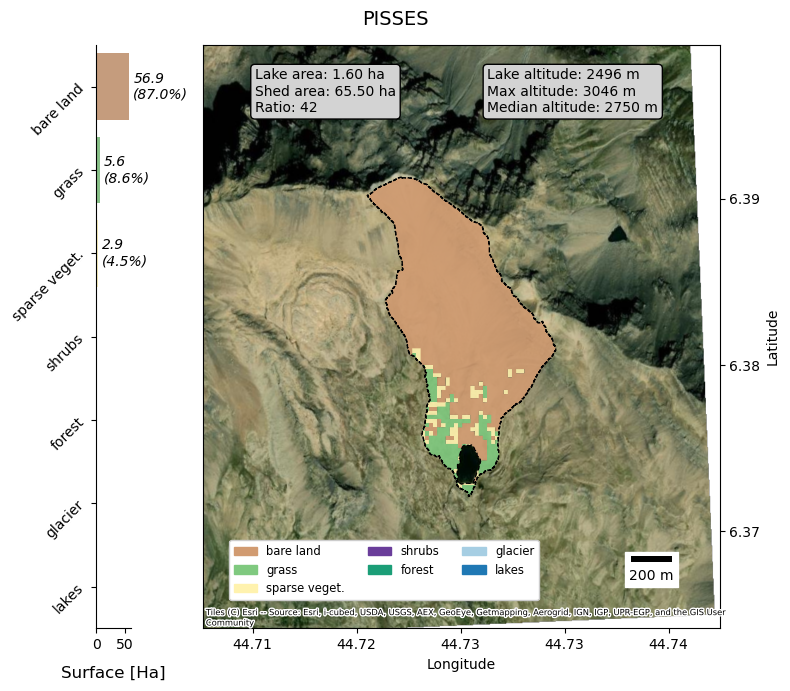

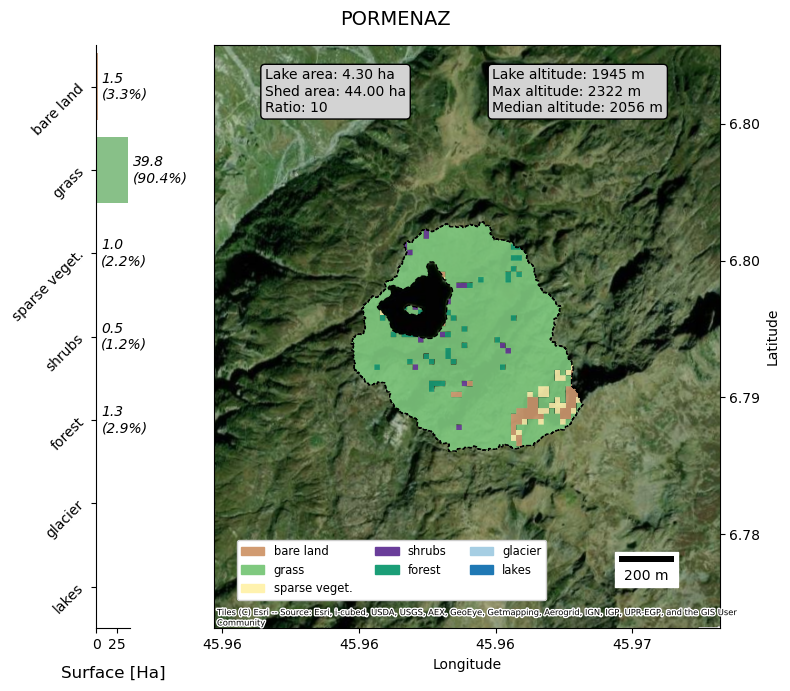

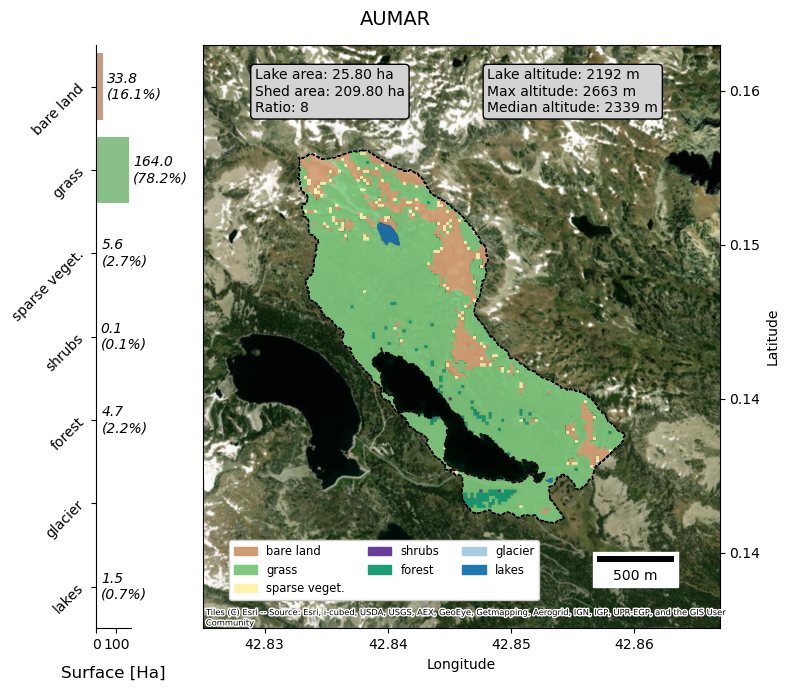

In [55]:
lacs_sentinelles_plots_stats.plot_landcover(stat_file=os.path.join(save_dir, "statistics/lacsSentinelles_statistics.csv"),
                                            lcmap=lcmap, 
                                            data_dir=save_dir,
                                            save_fig=save_dir)